In [1]:
# Import required libraries
import torch
import torch.nn.functional as F
import numpy as np
import cv2
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import os
import pandas as pd
from tqdm import tqdm
import glob
import math

from model.cnn3d import CNN3D
from model.vit import VisionTransformer
from model.mamba_cnn import OptimizedMambaCNN as MambaCNN
from ensemble_analysis import EnsembleModel, create_ensemble

In [2]:
# Load best hyperparameters from ablation results
ablation_df = pd.read_csv('results/ablation/ablation.csv')
best_params = {}
for idx, row in ablation_df.iterrows():
    best_params[row['model']] = {
        'window_size': int(row['window_size']),
        'window_step': int(row['window_step']),
        'max_seq_length': int(row['max_seq_length'])
    }

In [3]:
# Function to create windows
def create_windows_for_visualization(frame, window_size, window_step):
    """Create non-overlapping windows from a frame for visualization"""
    height, width = frame.shape
    windows = []
    positions = []
    
    for y in range(0, height - window_size + 1, window_step):
        for x in range(0, width - window_size + 1, window_step):
            window = frame[y:y+window_size, x:x+window_size]
            windows.append(window)
            positions.append((y, x))
    
    return windows, positions

In [4]:
# Function to display all patches and recombine them
def display_all_patches(frames, model, model_type, params, device):
    """Display all input windows and their corresponding predictions, with recombined output"""
    
    # Get parameters
    window_size = params['window_size']
    window_step = params['window_step']
    max_seq_length = params['max_seq_length']
    
    # Take a sequence of frames for testing
    start_idx = max_seq_length - 1  # Ensure we have enough frames
    frame_sequence = frames[start_idx-max_seq_length+1:start_idx+1]
    
    # Create windows from the last frame in the sequence
    last_frame = frame_sequence[-1]
    windows, positions = create_windows_for_visualization(last_frame, window_size, window_step)
    
    print(f"Created {len(windows)} windows of size {window_size}x{window_size}")
    print(f"Window positions: {positions}")
    
    # Create temporal windows
    temporal_windows = []
    for y, x in positions:
        temporal_window = []
        for frame in frame_sequence:
            window = frame[y:y+window_size, x:x+window_size]
            temporal_window.append(window)
        temporal_window = np.stack(temporal_window)
        temporal_windows.append(temporal_window)
    
    # Convert to tensor
    temporal_windows = np.array(temporal_windows)
    temporal_windows_tensor = torch.from_numpy(temporal_windows).float().to(device)
    
    # Normalize if needed
    if temporal_windows_tensor.max() > 1.0:
        temporal_windows_tensor = temporal_windows_tensor / 255.0
    
    # Get predictions
    model.eval()
    with torch.no_grad():
        outputs = model(temporal_windows_tensor)
        probs = F.softmax(outputs, dim=1)
        pred_maps = probs[:, 1].cpu().numpy()  # Get defect probability maps
    
    # Create visualization
    n_windows = len(windows)
    cols = math.ceil(math.sqrt(n_windows))
    rows = math.ceil(n_windows / cols)
    
    # Plot input windows
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()  # Flatten to make indexing easier
    
    for i, (window, (y, x)) in enumerate(zip(windows, positions)):
        if i < len(axes):
            axes[i].imshow(window, cmap='gray')
            axes[i].set_title(f'Window #{i}\nPos: ({y},{x})')
            axes[i].axis('off')
    
    # Hide unused subplots
    for i in range(n_windows, len(axes)):
        axes[i].axis('off')
    
    plt.suptitle(f'{model_type} - Input Windows', fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # Plot prediction maps
    fig, axes = plt.subplots(rows, cols, figsize=(15, 15))
    axes = axes.flatten()
    
    for i, (pred_map, (y, x)) in enumerate(zip(pred_maps, positions)):
        if i < len(axes):
            im = axes[i].imshow(pred_map, cmap='jet', vmin=0, vmax=1)
            axes[i].set_title(f'Prediction #{i}\nPos: ({y},{x})')
            axes[i].axis('off')
            # Add colorbar to first plot only
            if i == 0:
                plt.colorbar(im, ax=axes[0], label='Defect Probability')
    
    # Hide unused subplots
    for i in range(n_windows, len(axes)):
        axes[i].axis('off')
    
    plt.suptitle(f'{model_type} - Prediction Maps', fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # Recombine patches into a single image
    h, w = last_frame.shape
    recombined_pred = recombine_patches(pred_maps, positions, window_size, h, w)
    
    # Visualize the recombined prediction map
    plt.figure(figsize=(10, 10))
    im = plt.imshow(recombined_pred, cmap='jet', vmin=0, vmax=1)
    plt.title(f'{model_type} - Recombined Prediction Map')
    plt.colorbar(im, label='Defect Probability')
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # Print statistics
    print(f"\nPrediction Statistics for {model_type}:")
    for i, pred_map in enumerate(pred_maps):
        print(f"  Window #{i}: mean={pred_map.mean():.4f}, std={pred_map.std():.4f}, "
              f"min={pred_map.min():.4f}, max={pred_map.max():.4f}")
        unique_values = len(np.unique(pred_map.round(3)))
        print(f"    Unique values (rounded to 3 decimals): {unique_values}")
    
    # Print recombined statistics
    print(f"\nRecombined Prediction Statistics:")
    print(f"  Mean: {recombined_pred.mean():.4f}")
    print(f"  Std: {recombined_pred.std():.4f}")
    print(f"  Min: {recombined_pred.min():.4f}")
    print(f"  Max: {recombined_pred.max():.4f}")
    print(f"  Coverage: {(recombined_pred > 0).sum() / (h * w):.2%}")
    
    return recombined_pred  # Return the recombined prediction map

In [5]:
def recombine_patches(pred_maps, positions, window_size, full_height, full_width):
    """
    Recombine prediction patches into a single image, handling overlaps.
    
    Parameters:
    - pred_maps: List of prediction maps (numpy arrays)
    - positions: List of (y, x) positions for each patch
    - window_size: Size of each window
    - full_height: Height of the full image
    - full_width: Width of the full image
    
    Returns:
    - recombined: Reconstructed full-size prediction map
    """
    # Initialize the recombined map and a count map for averaging overlaps
    recombined = np.zeros((full_height, full_width), dtype=np.float32)
    count_map = np.zeros((full_height, full_width), dtype=np.uint8)
    
    # Place each prediction patch in the appropriate position
    for pred_map, (y, x) in zip(pred_maps, positions):
        # Handle edge cases where the window might extend beyond the image boundaries
        y_end = min(y + window_size, full_height)
        x_end = min(x + window_size, full_width)
        
        # Calculate the actual window size considering boundaries
        actual_h = y_end - y
        actual_w = x_end - x
        
        # Add prediction values to the recombined map
        recombined[y:y_end, x:x_end] += pred_map[:actual_h, :actual_w]
        
        # Increment the count map
        count_map[y:y_end, x:x_end] += 1
    
    # Average overlapping regions
    recombined[count_map > 0] = recombined[count_map > 0] / count_map[count_map > 0]
    
    return recombined

In [6]:
def process_all_frames_and_create_video(frames, model, model_type, params, device, 
                                       current_defect_threshold=0.7, future_defect_threshold=0.4,
                                       output_dir='videos', fps=5, requires_padding=True):
    """
    Process all frames, create predictions, apply thresholds, and create a video with overlays.
    Starts from the first frame and handles padding for models that require full sequences.
    
    Parameters:
    - frames: Array of frames
    - model: Trained model
    - model_type: Name/identifier for the model
    - params: Dictionary of parameters (window_size, window_step, max_seq_length)
    - device: PyTorch device (cpu/gpu)
    - current_defect_threshold: Threshold for current defects (shown in red)
    - future_defect_threshold: Threshold for likely future defects (shown in yellow)
    - output_dir: Directory to save the video
    - fps: Frames per second for output video
    - requires_padding: If True, pads with zeros for models that need full sequences (e.g., CNN)
    
    Returns:
    - video_path: Path to the created video file
    - frame_predictions: List of prediction maps for each frame
    """
    
    import cv2
    from pathlib import Path
    
    # Get parameters
    window_size = params['window_size']
    window_step = params['window_step']
    max_seq_length = params['max_seq_length']
    
    # Create output directory if it doesn't exist
    output_dir = Path(output_dir)
    output_dir.mkdir(exist_ok=True)
    
    # Prepare video writer
    h, w = frames[0].shape
    video_path = output_dir / f"{model_type}_predictions_{current_defect_threshold}_{future_defect_threshold}.mp4"
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')
    video_writer = cv2.VideoWriter(str(video_path), fourcc, fps, (w, h))
    
    # Store all predictions
    frame_predictions = []
    
    # Create padding frames if needed (all zeros)
    if requires_padding:
        padding_frame = np.zeros_like(frames[0])
    
    # Process each frame starting from 0
    for frame_idx in range(len(frames)):
        print(f"Processing frame {frame_idx}/{len(frames) - 1}")
        
        # Get frame sequence with padding if needed
        frame_sequence = []
        for i in range(max_seq_length):
            seq_idx = frame_idx - (max_seq_length - 1 - i)
            if seq_idx < 0 and requires_padding:
                # Add padding for frames before the start
                frame_sequence.append(padding_frame)
            elif seq_idx >= 0:
                frame_sequence.append(frames[seq_idx])
        
        # If we don't have enough frames and no padding is required
        if len(frame_sequence) < max_seq_length and not requires_padding:
            # Skip this frame if we can't form a complete sequence
            continue
            
        current_frame = frames[frame_idx]
        
        # Create windows from the current frame
        windows, positions = create_windows_for_visualization(current_frame, window_size, window_step)
        
        # Create temporal windows
        temporal_windows = []
        for y, x in positions:
            temporal_window = []
            for frame in frame_sequence:
                window = frame[y:y+window_size, x:x+window_size]
                temporal_window.append(window)
            temporal_window = np.stack(temporal_window)
            temporal_windows.append(temporal_window)
        
        # Convert to tensor
        temporal_windows = np.array(temporal_windows)
        temporal_windows_tensor = torch.from_numpy(temporal_windows).float().to(device)
        
        # Normalize if needed
        if temporal_windows_tensor.max() > 1.0:
            temporal_windows_tensor = temporal_windows_tensor / 255.0
        
        # Get predictions
        model.eval()
        with torch.no_grad():
            outputs = model(temporal_windows_tensor)
            probs = F.softmax(outputs, dim=1)
            pred_maps = probs[:, 1].cpu().numpy()  # Get defect probability maps
        
        # Recombine patches
        recombined_pred = recombine_patches(pred_maps, positions, window_size, h, w)
        frame_predictions.append(recombined_pred)
        
        # Create overlay
        overlay_frame = create_defect_overlay(current_frame, recombined_pred, 
                                            current_defect_threshold, future_defect_threshold)
        
        # Write frame to video
        # Convert to BGR for OpenCV
        bgr_frame = cv2.cvtColor(overlay_frame, cv2.COLOR_RGB2BGR)
        video_writer.write(bgr_frame)
    
    # Release video writer
    video_writer.release()
    
    print(f"Video saved to: {video_path}")
    return str(video_path), frame_predictions

In [7]:
def create_defect_overlay(original_frame, prediction_map, high_threshold, low_threshold):
    """
    Create an overlay on the original frame with defect predictions.
    
    Parameters:
    - original_frame: Original grayscale frame
    - prediction_map: Prediction probability map
    - high_threshold: Threshold for current defects (shown in red)
    - low_threshold: Threshold for likely future defects (shown in yellow)
    
    Returns:
    - overlay_frame: Frame with overlaid defect indicators
    """
    
    # Convert to uint8 if needed for OpenCV
    if original_frame.dtype != np.uint8:
        # Normalize if necessary
        if original_frame.max() <= 1.0:
            frame_to_display = (original_frame * 255).astype(np.uint8)
        else:
            frame_to_display = original_frame.astype(np.uint8)
    else:
        frame_to_display = original_frame.copy()
    
    # Convert grayscale to RGB
    rgb_frame = cv2.cvtColor(frame_to_display, cv2.COLOR_GRAY2RGB)
    
    # Create overlays
    current_defects = prediction_map >= high_threshold
    likely_defects = (prediction_map >= low_threshold) & (prediction_map < high_threshold)
    
    # Create colored overlays
    red_overlay = np.zeros_like(rgb_frame)
    red_overlay[:,:,0] = current_defects * 255  # Red channel
    
    yellow_overlay = np.zeros_like(rgb_frame)
    yellow_overlay[:,:,0] = likely_defects * 255  # Red channel
    yellow_overlay[:,:,1] = likely_defects * 255  # Green channel
    
    # Apply overlays with alpha blending
    alpha_high = 0.7  # More opaque for current defects
    alpha_low = 0.4   # Less opaque for likely future defects
    
    # Apply red overlay for current defects
    overlay_frame = rgb_frame.copy()
    mask_high = current_defects[:,:,np.newaxis]
    overlay_frame = np.where(mask_high, 
                           cv2.addWeighted(rgb_frame, 1-alpha_high, red_overlay, alpha_high, 0),
                           overlay_frame)
    
    # Apply yellow overlay for likely defects
    mask_low = likely_defects[:,:,np.newaxis]
    overlay_frame = np.where(mask_low,
                           cv2.addWeighted(overlay_frame, 1-alpha_low, yellow_overlay, alpha_low, 0),
                           overlay_frame)
    
    return overlay_frame

In [8]:
def process_all_models(frames, models_dict, params, device, 
                      current_defect_threshold=0.7, future_defect_threshold=0.4,
                      output_dir='videos', fps=10, model_padding_requirements=None):
    """
    Process all models and create videos for each, with proper padding handling.
    
    Parameters:
    - frames: Array of frames
    - models_dict: Dictionary of {model_name: model} pairs
    - params: Dictionary of parameters
    - device: PyTorch device
    - current_defect_threshold: Threshold for current defects
    - future_defect_threshold: Threshold for future defects
    - output_dir: Directory to save videos
    - fps: Frames per second
    - model_padding_requirements: Dictionary specifying padding needs for each model
                                {model_name: True/False}. If None, defaults to True
    
    Returns:
    - results: Dictionary with video paths and predictions for each model
    """
    
    results = {}
    
    # Default padding requirements if not specified
    if model_padding_requirements is None:
        model_padding_requirements = {name: True for name in models_dict.keys()}
    
    for model_name, model in models_dict.items():
        print(f"\n{'='*50}")
        print(f"Processing model: {model_name}")
        print(f"{'='*50}")
        
        # Get padding requirement for this model
        requires_padding = model_padding_requirements.get(model_name, True)
        
        # Process frames and create video
        video_path, predictions = process_all_frames_and_create_video(
            frames=frames,
            model=model,
            model_type=model_name,
            params=params,
            device=device,
            current_defect_threshold=current_defect_threshold,
            future_defect_threshold=future_defect_threshold,
            output_dir=output_dir,
            fps=fps,
            requires_padding=requires_padding
        )
        
        results[model_name] = {
            'video_path': video_path,
            'predictions': predictions
        }
        
        # Display sample frames for comparison
        display_sample_frames(frames, predictions, model_name, 
                            current_defect_threshold, future_defect_threshold)
    
    return results

In [9]:
def display_sample_frames(frames, predictions, model_name, high_threshold, low_threshold):
    """Display sample frames with predictions for visual inspection."""
    
    # Select a few sample frames to display
    sample_indices = [len(frames)//4, len(frames)//2, 3*len(frames)//4 - 1]
    
    fig, axes = plt.subplots(3, 3, figsize=(15, 15))
    
    for i, idx in enumerate(sample_indices):
        if idx < len(predictions):
            # Original frame
            axes[i, 0].imshow(frames[idx], cmap='gray')
            axes[i, 0].set_title(f'Original Frame {idx}')
            axes[i, 0].axis('off')
            
            # Prediction heat map
            im = axes[i, 1].imshow(predictions[idx], cmap='jet', vmin=0, vmax=1)
            axes[i, 1].set_title(f'Prediction Heat Map')
            axes[i, 1].axis('off')
            
            # Overlaid frame
            overlay = create_defect_overlay(frames[idx], predictions[idx], 
                                          high_threshold, low_threshold)
            axes[i, 2].imshow(overlay)
            axes[i, 2].set_title(f'Overlaid Defects')
            axes[i, 2].axis('off')
        else:
            # Empty subplots
            for j in range(3):
                axes[i, j].axis('off')
    
    # Add colorbar
    #plt.colorbar(im, ax=axes[:, 1], label='Defect Probability', orientation='horizontal', 
    #             fraction=0.05, pad=0.2)
    
    plt.suptitle(f'{model_name} - Sample Frames with Predictions', fontsize=16)
    plt.tight_layout()
    plt.show()

In [10]:
# Function to show original image with window grid
def visualize_window_grid(frame, window_size, window_step):
    """Visualize the grid of windows on the original image"""
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    
    # Display the frame
    ax.imshow(frame, cmap='gray')
    
    # Add grid lines for windows
    height, width = frame.shape
    
    # Vertical lines
    for x in range(0, width - window_size + 1, window_step):
        ax.axvline(x=x, color='red', linestyle='--', alpha=0.7)
        ax.axvline(x=x+window_size, color='red', linestyle='--', alpha=0.7)
    
    # Horizontal lines
    for y in range(0, height - window_size + 1, window_step):
        ax.axhline(y=y, color='red', linestyle='--', alpha=0.7)
        ax.axhline(y=y+window_size, color='red', linestyle='--', alpha=0.7)
    
    ax.set_title(f'Window Grid (size={window_size}, step={window_step})')
    plt.tight_layout()
    plt.show()

In [11]:
def load_model(model_type, hyperparams, model_path, device):
    """Load a trained model with appropriate hyperparameters"""
    max_seq_length = hyperparams['max_seq_length']
    window_size = hyperparams['window_size']
    
    if model_type == 'cnn3d':
        model = CNN3D(max_seq_length=max_seq_length, in_channels=1, out_channels=2)
    elif model_type == 'mamba':
        model = MambaCNN(
            img_size=window_size,
            in_channels=1,
            max_seq_length=max_seq_length,
            num_classes=2,
            base_channels=64,
            d_state=16,
            depth=2
        )
    elif model_type == 'vit':
        model = VisionTransformer(
            img_size=window_size,
            patch_size=16,
            in_channels=1,
            max_seq_length=max_seq_length,
            num_classes=2,
            embed_dim=256,
            depth=6,
            num_heads=8
        )
    else:
        raise ValueError(f"Unknown model type: {model_type}")
    
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    return model

In [12]:
# Load frames
frames_dir = "data/frames"  # Adjust this path
frame_files = sorted(glob.glob(os.path.join(frames_dir, "*.png")))

frames = []
for frame_file in frame_files:  # Load first 20 frames for testing
    frame = cv2.imread(frame_file, cv2.IMREAD_GRAYSCALE)
    if frame.max() > 1.0:
        frame = frame / 255.0  # Normalize to [0, 1]
    frames.append(frame)

print(f"Loaded {len(frames)} frames with shape {frames[0].shape}")

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Process each model
models_dir = "results/final_models"  # Adjust this path

models = {}

# for model_type, params in best_params.items():
#     print(f"\n{'='*50}")
#     print(f"Processing {model_type} model")
#     print(f"{'='*50}")
    
#     # Show window grid
#     visualize_window_grid(frames[0], params['window_size'], params['window_step'])
    
#     # Load model
#     model_path = os.path.join(models_dir, f"{model_type}/{model_type}_best_acc.pth")
#     if not os.path.exists(model_path):
#         model_path = os.path.join(models_dir, f"{model_type}_best_acc.pth")
    
#     model = load_model(model_type, params, model_path, device)
#     models_dict[model_type] = model
    
#     # Display all patches
#     display_all_patches(frames, model, model_type, params, device)

# # Create a simple visualization to check if windows are extracted correctly
# print("\nVerifying window extraction:")
# test_frame = frames[0]
# window_size = 256
# window_step = 64

# # Create windows
# test_windows, test_positions = create_windows_for_visualization(test_frame, window_size, window_step)

# # Show first few windows
# fig, axes = plt.subplots(1, 4, figsize=(20, 5))
# for i in range(min(4, len(test_windows))):
#     axes[i].imshow(test_windows[i], cmap='gray')
#     axes[i].set_title(f'Window #{i}\nPos: {test_positions[i]}')
#     axes[i].axis('off')

# plt.suptitle('Sample Extracted Windows', fontsize=16)
# plt.tight_layout()
# plt.show()

Loaded 100 frames with shape (512, 512)
Using device: cuda


In [13]:
# Specify which models need padding
model_padding_requirements = {
    'CNN': True,    # CNN needs padding for early frames
    'ViT': False,   # ViT can handle short sequences
    'Mamba': False  # Mamba can handle short sequences
}

In [14]:
for model_type, params in best_params.items():
    model_path = os.path.join(models_dir, f"{model_type}",f"{model_type}_best_acc.pth")

    model = load_model(model_type, params, model_path, device)
    models[model_type] = model


Processing model: cnn3d
Processing frame 0/99
Processing frame 1/99
Processing frame 2/99
Processing frame 3/99
Processing frame 4/99
Processing frame 5/99
Processing frame 6/99
Processing frame 7/99
Processing frame 8/99
Processing frame 9/99
Processing frame 10/99
Processing frame 11/99
Processing frame 12/99
Processing frame 13/99
Processing frame 14/99
Processing frame 15/99
Processing frame 16/99
Processing frame 17/99
Processing frame 18/99
Processing frame 19/99
Processing frame 20/99
Processing frame 21/99
Processing frame 22/99
Processing frame 23/99
Processing frame 24/99
Processing frame 25/99
Processing frame 26/99
Processing frame 27/99
Processing frame 28/99
Processing frame 29/99
Processing frame 30/99
Processing frame 31/99
Processing frame 32/99
Processing frame 33/99
Processing frame 34/99
Processing frame 35/99
Processing frame 36/99
Processing frame 37/99
Processing frame 38/99
Processing frame 39/99
Processing frame 40/99
Processing frame 41/99
Processing frame 42

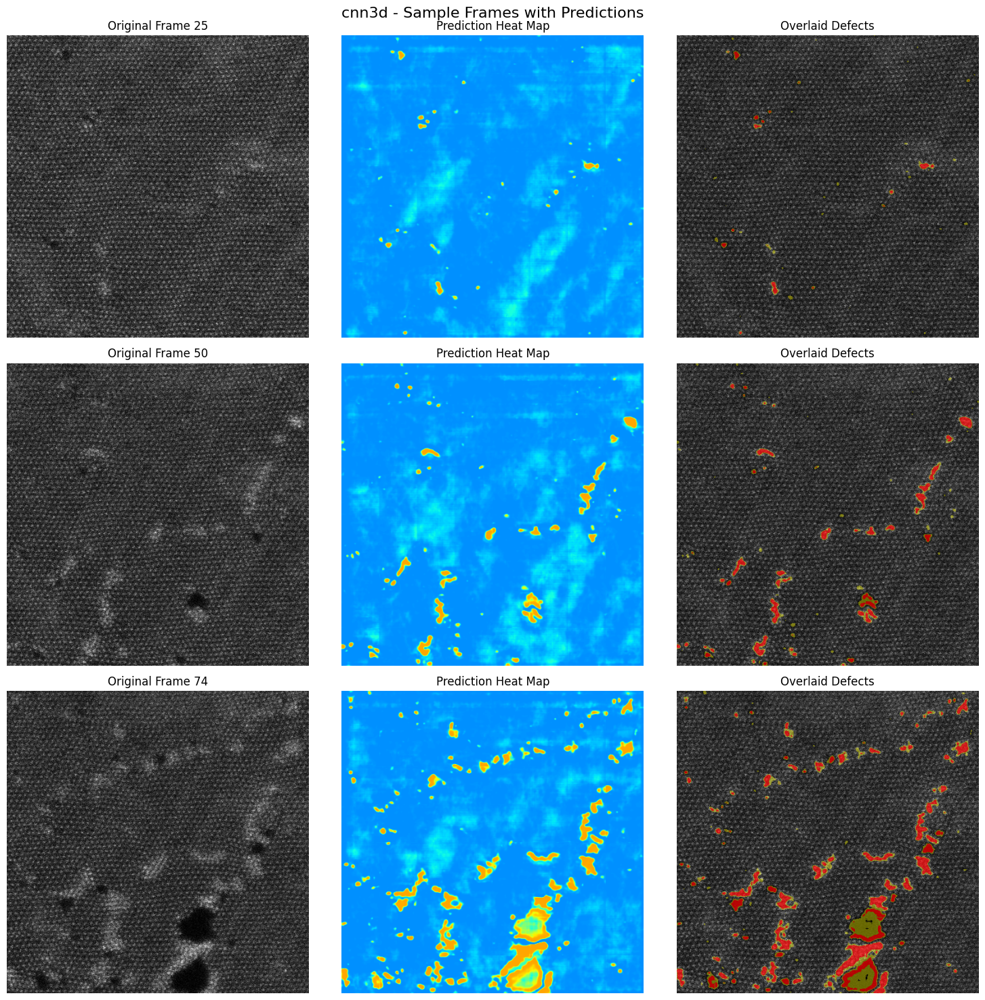


Processing model: vit
Processing frame 0/99
Processing frame 1/99
Processing frame 2/99
Processing frame 3/99
Processing frame 4/99
Processing frame 5/99
Processing frame 6/99
Processing frame 7/99
Processing frame 8/99
Processing frame 9/99
Processing frame 10/99
Processing frame 11/99
Processing frame 12/99
Processing frame 13/99
Processing frame 14/99
Processing frame 15/99
Processing frame 16/99
Processing frame 17/99
Processing frame 18/99
Processing frame 19/99
Processing frame 20/99
Processing frame 21/99
Processing frame 22/99
Processing frame 23/99
Processing frame 24/99
Processing frame 25/99
Processing frame 26/99
Processing frame 27/99
Processing frame 28/99
Processing frame 29/99
Processing frame 30/99
Processing frame 31/99
Processing frame 32/99
Processing frame 33/99
Processing frame 34/99
Processing frame 35/99
Processing frame 36/99
Processing frame 37/99
Processing frame 38/99
Processing frame 39/99
Processing frame 40/99
Processing frame 41/99
Processing frame 42/9

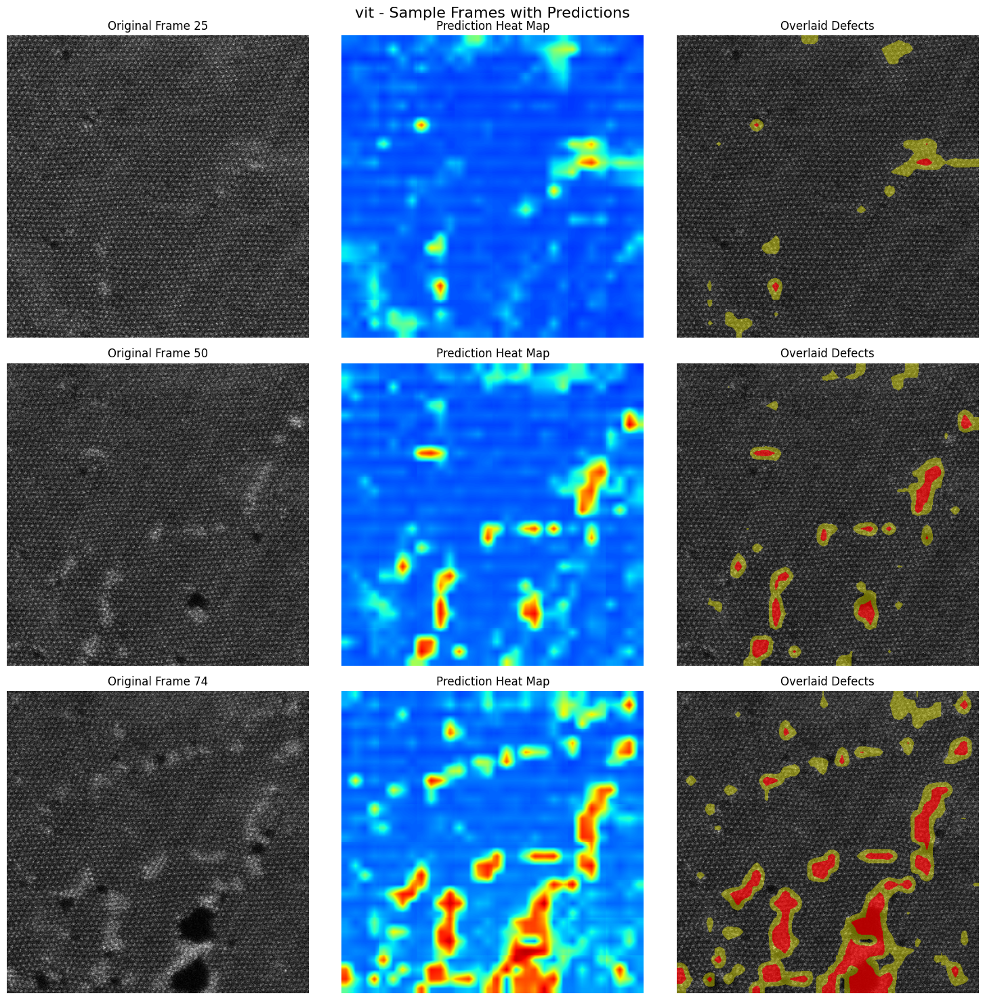


Processing model: mamba
Processing frame 0/99
Processing frame 1/99
Processing frame 2/99
Processing frame 3/99
Processing frame 4/99
Processing frame 5/99
Processing frame 6/99
Processing frame 7/99
Processing frame 8/99
Processing frame 9/99
Processing frame 10/99
Processing frame 11/99
Processing frame 12/99
Processing frame 13/99
Processing frame 14/99
Processing frame 15/99
Processing frame 16/99
Processing frame 17/99
Processing frame 18/99
Processing frame 19/99
Processing frame 20/99
Processing frame 21/99
Processing frame 22/99
Processing frame 23/99
Processing frame 24/99
Processing frame 25/99
Processing frame 26/99
Processing frame 27/99
Processing frame 28/99
Processing frame 29/99
Processing frame 30/99
Processing frame 31/99
Processing frame 32/99
Processing frame 33/99
Processing frame 34/99
Processing frame 35/99
Processing frame 36/99
Processing frame 37/99
Processing frame 38/99
Processing frame 39/99
Processing frame 40/99
Processing frame 41/99
Processing frame 42

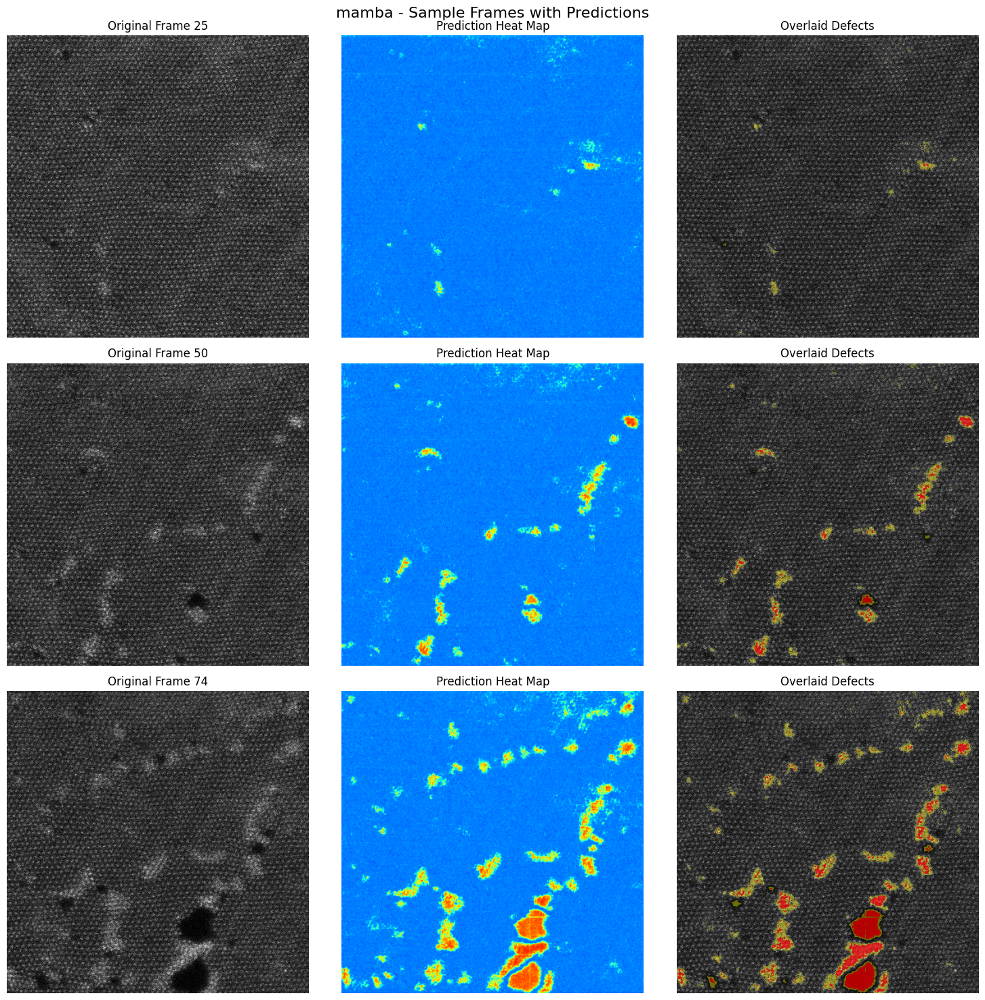

In [15]:
# Process all models and create videos
results = process_all_models(
    frames=frames,
    models_dict=models,
    params=params,
    device=device,
    current_defect_threshold=0.7,
    future_defect_threshold=0.4,
    output_dir='output_videos',
    fps=5,
    model_padding_requirements=model_padding_requirements
)


=== Creating and Visualizing Weighted Ensemble ===


Ensemble weights:
  cnn3d: 0.8333
  vit: 0.0000
  mamba: 0.1667

Ensemble weights based on validation MIoU:
  cnn3d: 0.8333
  vit: 0.0000
  mamba: 0.1667

Ensemble parameters: window_size=256, window_step=64, max_seq_length=5


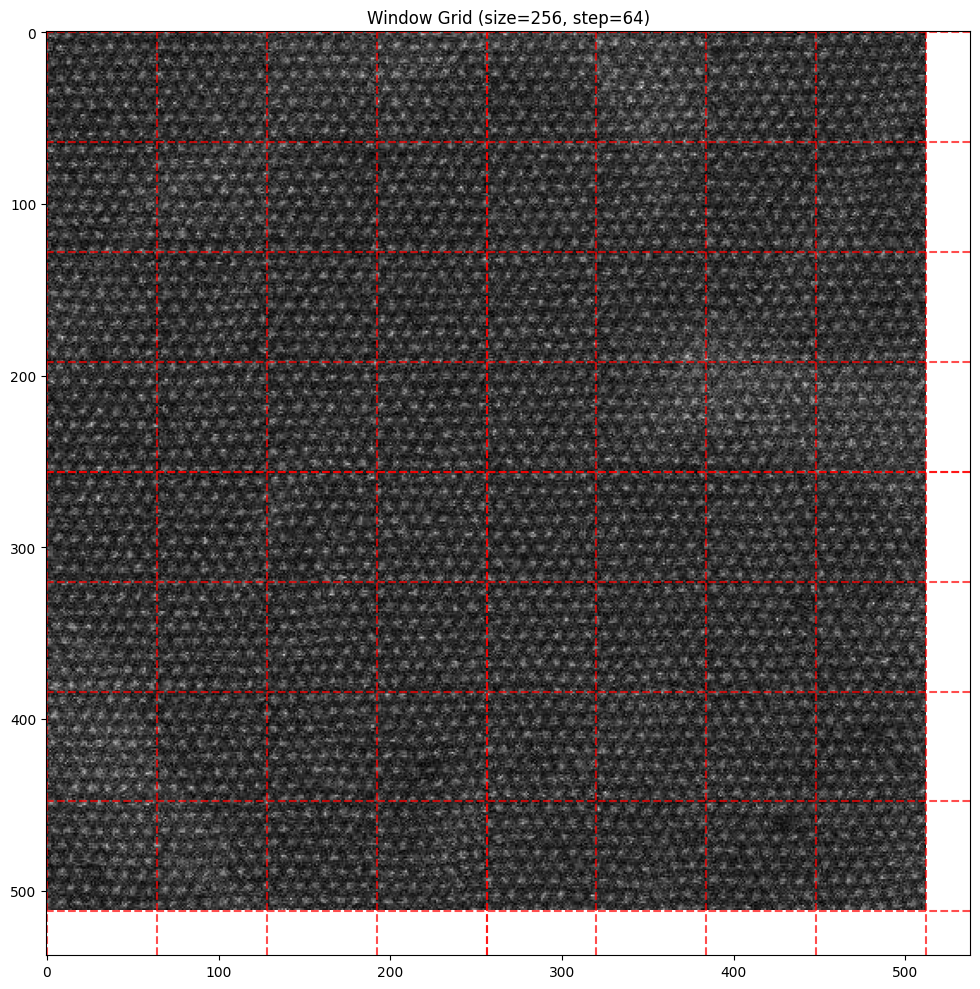

Created 25 windows of size 256x256
Window positions: [(0, 0), (0, 64), (0, 128), (0, 192), (0, 256), (64, 0), (64, 64), (64, 128), (64, 192), (64, 256), (128, 0), (128, 64), (128, 128), (128, 192), (128, 256), (192, 0), (192, 64), (192, 128), (192, 192), (192, 256), (256, 0), (256, 64), (256, 128), (256, 192), (256, 256)]


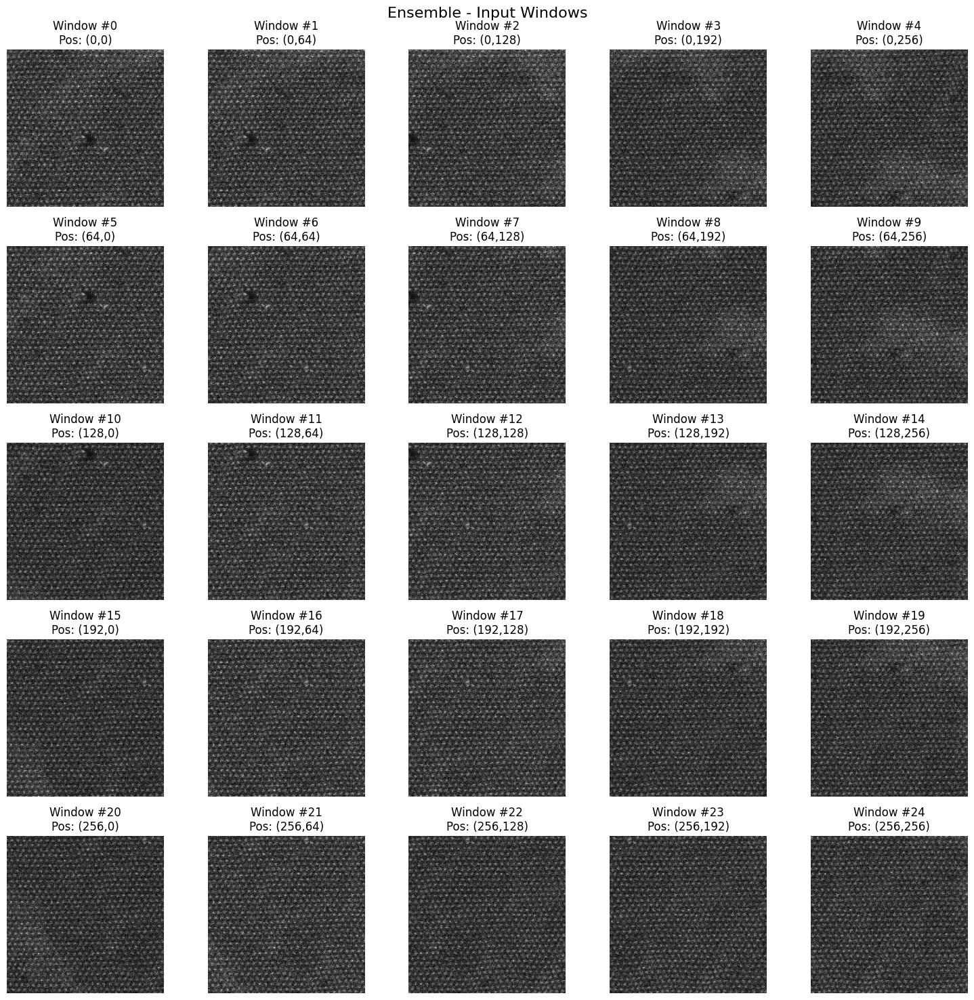

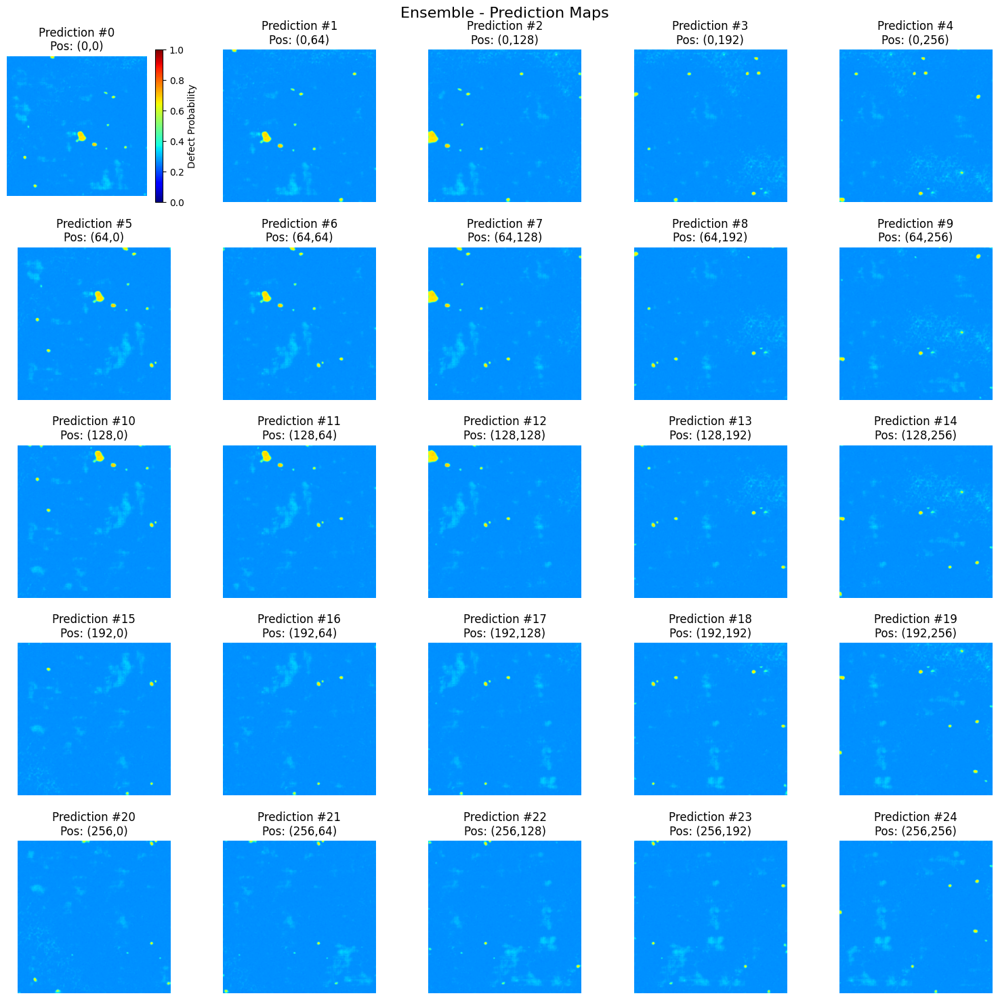

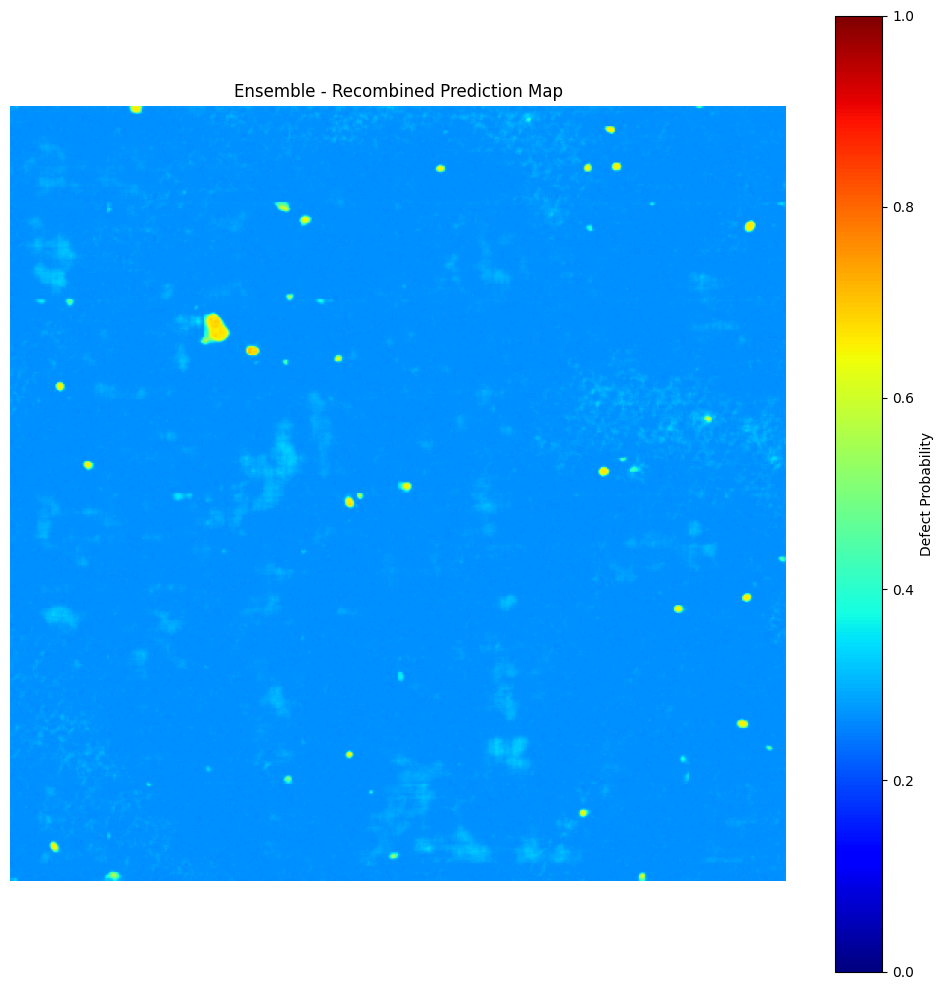


Prediction Statistics for Ensemble:
  Window #0: mean=0.2720, std=0.0274, min=0.2583, max=0.7099
    Unique values (rounded to 3 decimals): 321
  Window #1: mean=0.2716, std=0.0272, min=0.2583, max=0.7099
    Unique values (rounded to 3 decimals): 314
  Window #2: mean=0.2722, std=0.0291, min=0.2578, max=0.7099
    Unique values (rounded to 3 decimals): 317
  Window #3: mean=0.2707, std=0.0188, min=0.2601, max=0.6655
    Unique values (rounded to 3 decimals): 245
  Window #4: mean=0.2712, std=0.0201, min=0.2571, max=0.6661
    Unique values (rounded to 3 decimals): 253
  Window #5: mean=0.2720, std=0.0287, min=0.2573, max=0.7099
    Unique values (rounded to 3 decimals): 331
  Window #6: mean=0.2714, std=0.0280, min=0.2573, max=0.7099
    Unique values (rounded to 3 decimals): 322
  Window #7: mean=0.2720, std=0.0304, min=0.2573, max=0.7099
    Unique values (rounded to 3 decimals): 308
  Window #8: mean=0.2700, std=0.0166, min=0.2598, max=0.6914
    Unique values (rounded to 3 decima

array([[0.2731992 , 0.2757113 , 0.27631006, ..., 0.26859814, 0.27004656,
        0.2799018 ],
       [0.2786535 , 0.28298062, 0.28136876, ..., 0.26973864, 0.26842958,
        0.2693295 ],
       [0.2786545 , 0.28010002, 0.2798533 , ..., 0.27134347, 0.26903978,
        0.27087098],
       ...,
       [0.2730711 , 0.26983333, 0.26851118, ..., 0.26865548, 0.26799235,
        0.27362874],
       [0.303518  , 0.29574797, 0.30891055, ..., 0.27061492, 0.26952848,
        0.27085716],
       [0.29581925, 0.29719004, 0.3129528 , ..., 0.26890713, 0.27043447,
        0.27088386]], dtype=float32)

In [16]:
# Add ensemble visualization
print("\n=== Creating and Visualizing Weighted Ensemble ===")

# Model types to include in ensemble
model_types = ['cnn3d', 'vit', 'mamba']

# Use MIoU values as weights for ensemble
results_path = os.path.join(models_dir, "final_results.csv")
results_df = pd.read_csv(results_path)
miou_values = results_df.set_index('model')['val_miou'].to_dict()

# Create ensemble model
ensemble, common_params = create_ensemble(model_types, models_dir, device, weights={'cnn3d':1.0, 'vit':0.0, 'mamba':0.2})

# Display ensemble weights
print("\nEnsemble weights based on validation MIoU:")
for model_type, weight in ensemble.weights.items():
    print(f"  {model_type}: {weight:.4f}")

# Get parameters for visualization
window_size = common_params['window_size']
window_step = common_params['window_step']
max_seq_length = common_params['max_seq_length']

print(f"\nEnsemble parameters: window_size={window_size}, window_step={window_step}, max_seq_length={max_seq_length}")

# Show window grid for ensemble
visualize_window_grid(frames[0], window_size, window_step)

# Display all patches for ensemble
display_all_patches(frames, ensemble, "Ensemble", common_params, device)


Processing model: ensemble
Processing frame 0/99
Processing frame 1/99
Processing frame 2/99
Processing frame 3/99
Processing frame 4/99
Processing frame 5/99
Processing frame 6/99
Processing frame 7/99
Processing frame 8/99
Processing frame 9/99
Processing frame 10/99
Processing frame 11/99
Processing frame 12/99
Processing frame 13/99
Processing frame 14/99
Processing frame 15/99
Processing frame 16/99
Processing frame 17/99
Processing frame 18/99
Processing frame 19/99
Processing frame 20/99
Processing frame 21/99
Processing frame 22/99
Processing frame 23/99
Processing frame 24/99
Processing frame 25/99
Processing frame 26/99
Processing frame 27/99
Processing frame 28/99
Processing frame 29/99
Processing frame 30/99
Processing frame 31/99
Processing frame 32/99
Processing frame 33/99
Processing frame 34/99
Processing frame 35/99
Processing frame 36/99
Processing frame 37/99
Processing frame 38/99
Processing frame 39/99
Processing frame 40/99
Processing frame 41/99
Processing frame

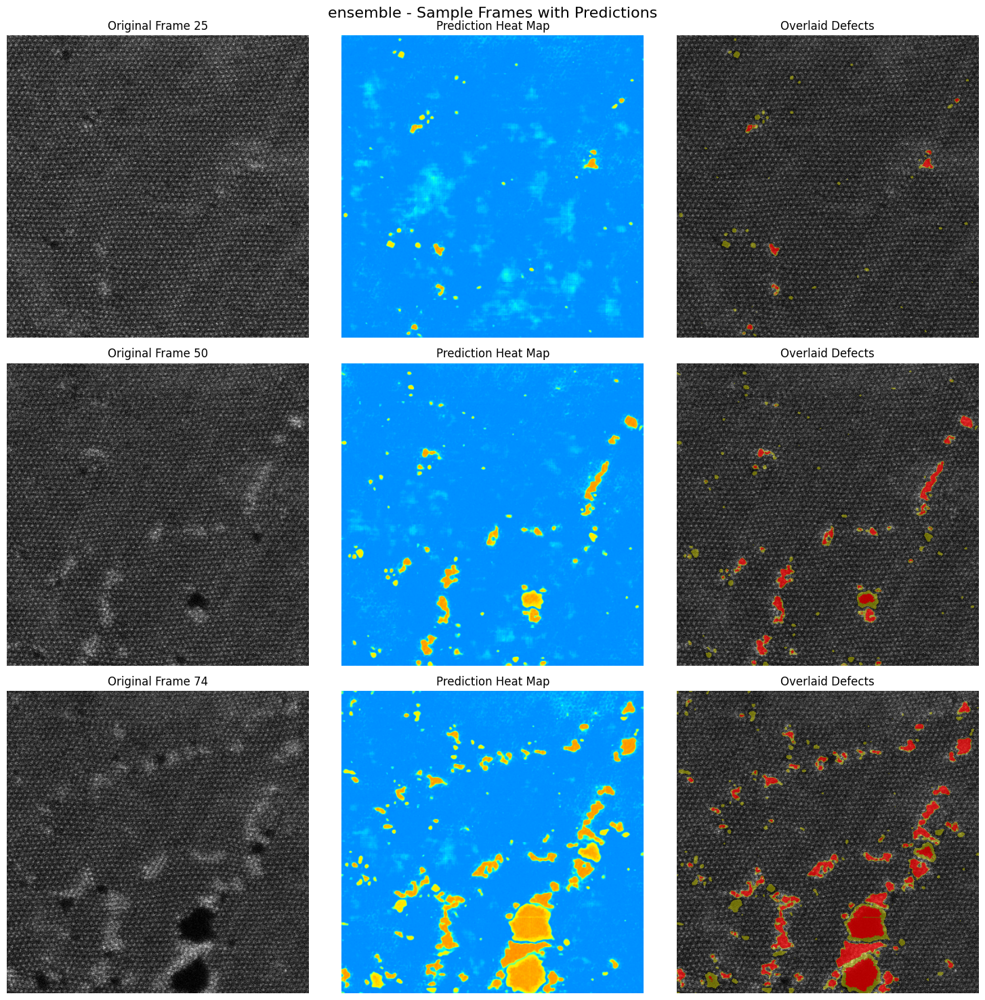

In [17]:
# Add ensemble to models dictionary for video creation
models["ensemble"] = ensemble

# Process the ensemble model and create video
ensemble_results = process_all_models(
    frames=frames,
    models_dict={"ensemble": ensemble},  # Just process the ensemble
    params=common_params,
    device=device,
    current_defect_threshold=0.7,
    future_defect_threshold=0.4,
    output_dir='output_videos',
    fps=5,
    model_padding_requirements={"ensemble": False}  # Ensemble can handle short sequences
)

In [18]:
# Compare predictions from individual models with ensemble
def compare_model_predictions(frames, models_dict, ensemble_model, common_params, 
                             device, frame_idx=10, current_threshold=0.7, future_threshold=0.4):
    """Compare predictions from individual models with the ensemble for a specific frame"""
    
    if frame_idx >= len(frames):
        frame_idx = len(frames) - 1
        print(f"Frame index too large, using last frame ({frame_idx})")
    
    # Get current frame
    current_frame = frames[frame_idx]
    
    # Get parameters
    window_size = common_params['window_size']
    window_step = common_params['window_step']
    max_seq_length = common_params['max_seq_length']
    
    # Extract sequence
    start_idx = max(0, frame_idx - max_seq_length + 1)
    frame_sequence = frames[start_idx:frame_idx+1]
    
    # Pad sequence if needed
    if len(frame_sequence) < max_seq_length:
        padding_needed = max_seq_length - len(frame_sequence)
        padding_frames = [np.zeros_like(frames[0]) for _ in range(padding_needed)]
        frame_sequence = padding_frames + frame_sequence
    
    # Create windows from the current frame
    windows, positions = create_windows_for_visualization(current_frame, window_size, window_step)
    
    # Create temporal windows
    temporal_windows = []
    for y, x in positions:
        temporal_window = []
        for frame in frame_sequence:
            window = frame[y:y+window_size, x:x+window_size]
            temporal_window.append(window)
        temporal_window = np.stack(temporal_window)
        temporal_windows.append(temporal_window)
    
    # Convert to tensor
    temporal_windows = np.array(temporal_windows)
    temporal_windows_tensor = torch.from_numpy(temporal_windows).float().to(device)
    
    # Normalize if needed
    if temporal_windows_tensor.max() > 1.0:
        temporal_windows_tensor = temporal_windows_tensor / 255.0
    
    # Get predictions from all models including ensemble
    all_predictions = {}
    all_models = {**models_dict, "ensemble": ensemble_model}
    
    for model_name, model in all_models.items():
        model.eval()
        with torch.no_grad():
            outputs = model(temporal_windows_tensor)
            probs = F.softmax(outputs, dim=1)
            pred_maps = probs[:, 1].cpu().numpy()  # Get defect probability maps
            
            # Recombine predictions
            h, w = current_frame.shape
            recombined_pred = recombine_patches(pred_maps, positions, window_size, h, w)
            all_predictions[model_name] = recombined_pred
    
    # Create visualization
    n_models = len(all_predictions)
    fig, axes = plt.subplots(2, n_models, figsize=(n_models*5, 10))
    
    # Plot original frame at the top
    for i, (model_name, prediction) in enumerate(all_predictions.items()):
        # Original frame with overlay in top row
        overlay = create_defect_overlay(current_frame, prediction, 
                                      current_threshold, future_threshold)
        axes[0, i].imshow(overlay)
        axes[0, i].set_title(f"{model_name.upper()} Prediction")
        axes[0, i].axis('off')
        
        # Heatmap in bottom row
        im = axes[1, i].imshow(prediction, cmap='jet', vmin=0, vmax=1)
        axes[1, i].set_title(f"{model_name.upper()} Heatmap")
        axes[1, i].axis('off')
    
    # Add colorbar
    plt.tight_layout()
    fig.subplots_adjust(right=0.9)
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    fig.colorbar(im, cax=cbar_ax, label='Defect Probability')
    
    plt.suptitle(f"Model Predictions Comparison - Frame {frame_idx}", fontsize=16, y=0.98)
    plt.show()
    
    return all_predictions


=== Comparing model predictions for frame 5 ===


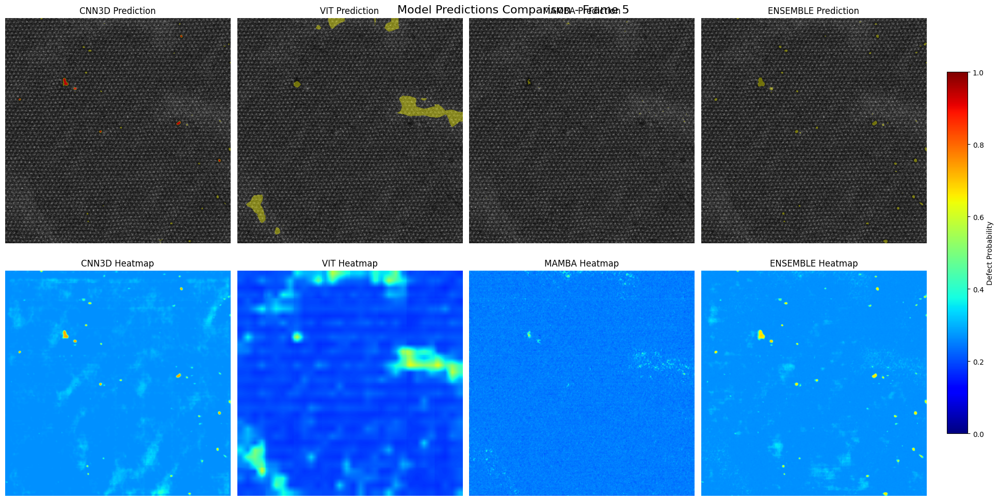


=== Comparing model predictions for frame 10 ===


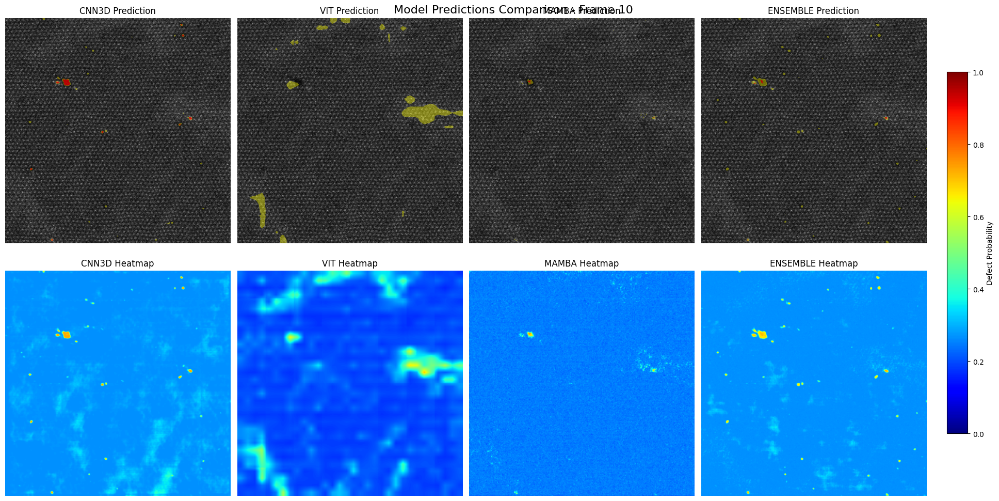


=== Comparing model predictions for frame 15 ===


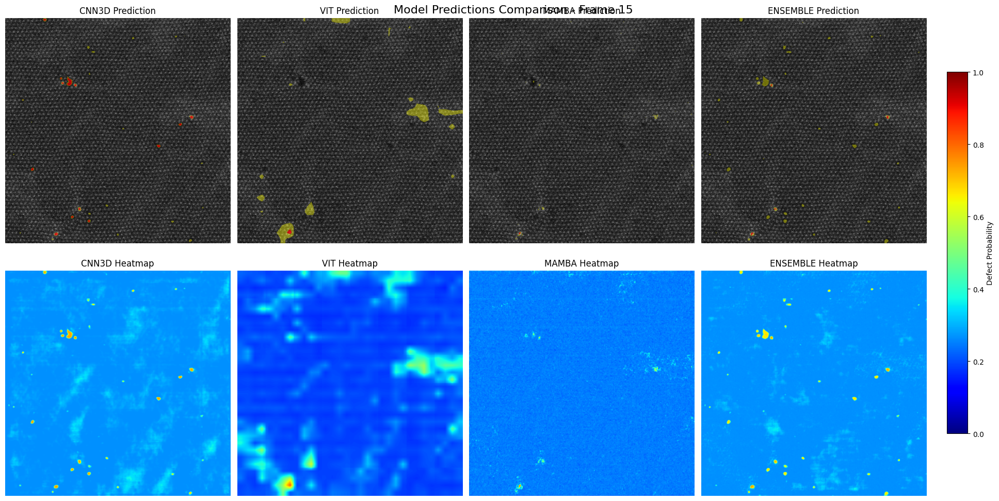

In [19]:
# Compare predictions for sample frames
comparison_frames = [5, 10, 15]  # Sample frame indices to compare

for frame_idx in comparison_frames:
    print(f"\n=== Comparing model predictions for frame {frame_idx} ===")
    
    compare_model_predictions(
        frames=frames,
        models_dict=models,
        ensemble_model=ensemble,
        common_params=common_params,
        device=device,
        frame_idx=frame_idx
    )